In [1]:
import os
import numpy as np
import scipy as sp
from sklearn.decomposition import PCA

import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()

sns.set(font_scale=1.3)

red = '#FF3300'
blue = '#0099CC'
green = '#00CC66'

# Метод главных компонент
### (Principal component analysis, PCA)

<a href="https://www.youtube.com/watch?v=JEYLfIVvR9I">It had to be U - the SVD song</a> — веселая песенка :)

Интерактивная визуализация PCA и собственных векторов:

* <a href="http://setosa.io/ev/principal-component-analysis/">Principal Component Analysis</a>

* <a href="http://setosa.io/ev/eigenvectors-and-eigenvalues/">Eigenvectors and Eigenvalues</a>

## 1. SVD-разложение

Генерируем датасет из равномерного распределения.

In [2]:
X = sp.stats.uniform.rvs(size=(100, 10))
print(X.shape)

(100, 10)


Вот так можно вычислять сингулярное разложение этого датасета.

In [3]:
U, D, V = sp.linalg.svd(X, full_matrices=False)
print(U.shape, D.shape, V.shape)

(100, 10) (10,) (10, 10)


Проверим, что получилось. Восстановим датасет и сравним с исходной версией.

In [4]:
X_restored = np.dot(U, np.dot(D * np.eye(10), V))
print(np.allclose(X_restored, X))

True


Восстановленная версия действительно очень близка к исходной.

## 2. PCA

Реализация из sklearn:

<a href="https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA">`sklearn.decomposition.PCA`</a>`(n_components=None)`

Методы класса:
* `fit(X)` — обучиться на данных `X`;
* `fit_transforn(X)` — обучиться на данных `X` и вернуть сжатое представление `X`;
* `transform(X_new)` — вернуть сжатое представление `X_new` для обученной ранее модели;
* `inverse_transform(Y)` — восстановить сжатые данные `Y` в исходное пространство.

Атрибуты класса:

* `components_` — главные компоненты в порядке убывания собственных чисел, размер (n_components, n_features);
* `explained_variance_` — дисперсия вдоль главных компонент, равны собственным числам, размер (n_components,);
* `explained_variance_ratio_` —- доля дисперсии, объясняемая каждой компонентой, размер (n_components,);
* `mean_` — среднее по данным, размер (n_components,);
* `noise_variance_` — оценка дисперсии шума для метода Probabilistic PCA.

Другие модификации, реализованные в sklearn:

* <a href="https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.KernelPCA">`KernelPCA`</a>;
* <a href="https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.SparsePCA">`SparsePCA`</a>;
* <a href="https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.IncrementalPCA">`IncrementalPCA`</a>.

Генерируем двумерный датасет из нормального распределения.

In [7]:
X = sp.stats.multivariate_normal.rvs(size=150, mean=[0, 3], 
                                     cov=[[3, 1], [1, 1]])

Применяем PCA с одной главной компонентой.

In [8]:
pca = PCA(n_components=1)
Y = pca.fit_transform(X)
X_hat = pca.inverse_transform(Y)

Его главные компоненты (точнее, одна компонента) — двумерные векторы.

In [9]:
pca.components_

array([[-0.89162754, -0.45276962]])

Вектор средних:

In [10]:
pca.mean_

array([-0.17333864,  2.86106292])

На первом графике синим отмечены исходные точки, красным - они же после проецирования и обратного преобразования.
На втором графике точки в одномерном пространстве.

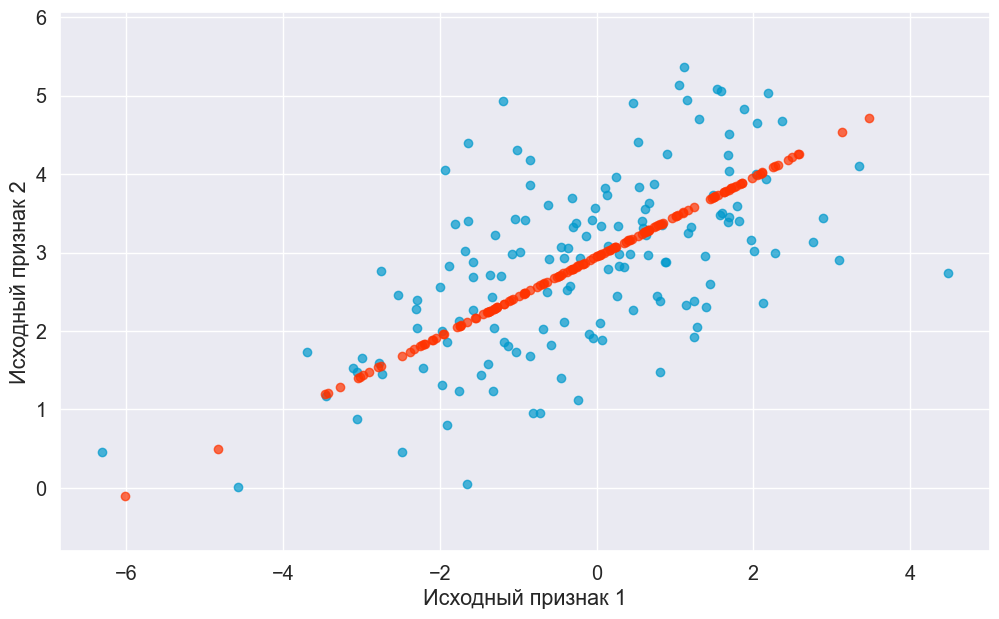

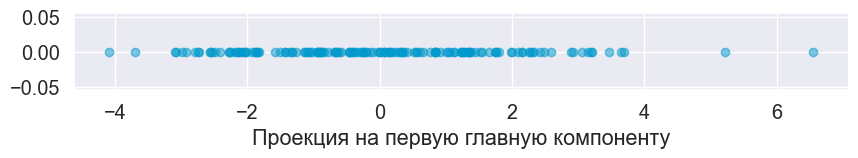

In [11]:
plt.figure(figsize=(12, 7))
plt.scatter(X[:, 0], X[:, 1], alpha=0.7, color=blue)
plt.scatter(X_hat[:, 0], X_hat[:, 1], color=red, alpha=0.7)
plt.xlabel('Исходный признак 1')
plt.ylabel('Исходный признак 2')
plt.axis('equal')
plt.show()

plt.figure(figsize=(10, 1))
plt.scatter(Y, np.zeros(len(Y)), alpha=0.5, color=blue)
plt.xlabel('Проекция на первую главную компоненту')
plt.show()

Сгенерируем и визуализируем два хорошо разделимых класса из нормального распределения с отличающимися векторами средних.

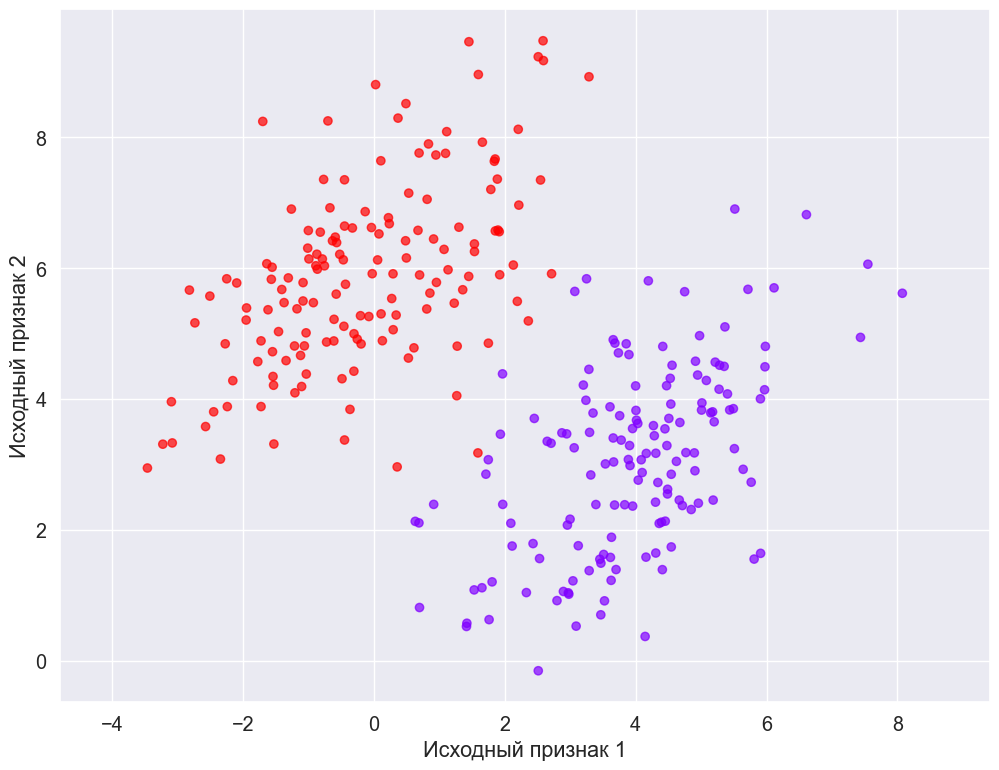

In [12]:
a = sp.stats.multivariate_normal.rvs(size=150, mean=[4, 3], 
                                     cov=[[2, 1], [1, 2]])
b = sp.stats.multivariate_normal.rvs(size=150, mean=[0, 6], 
                                     cov=[[2, 1], [1, 2]])
X = np.vstack([a, b])
c = np.hstack([np.zeros(len(a)), np.ones(len(b))])

plt.figure(figsize=(12, 9))
plt.scatter(X[:, 0], X[:, 1], c=c, alpha=0.7, cmap='rainbow')
plt.xlabel('Исходный признак 1')
plt.ylabel('Исходный признак 2')
plt.xlim((-5, 9)), plt.ylim((-1, 10))
plt.axis('equal')
plt.show()

Проецируем на одномерное подпространство, тут хорошо заметна пространственная структура классов. При помощи метода `inverse_transform`, применненного к результату разложения на нужное количество компонент, можно получить проекции на эти компоненты.

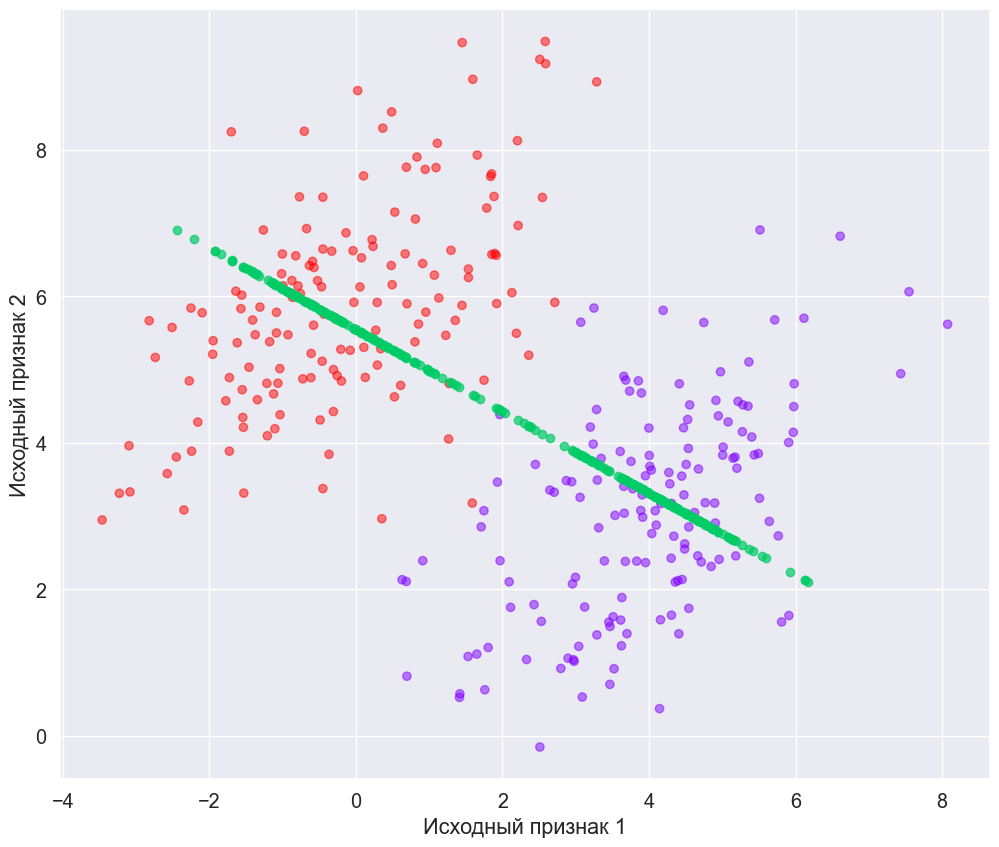

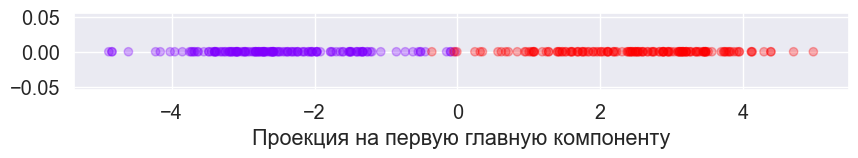

In [13]:
pca = PCA(n_components=1)
Y = pca.fit_transform(X)
X_hat = pca.inverse_transform(Y)

plt.figure(figsize=(12, 10))
plt.scatter(X[:, 0], X[:, 1], c=c, alpha=0.5, cmap='rainbow')
plt.scatter(X_hat[:, 0], X_hat[:, 1], c=green, alpha=0.7)
plt.xlabel('Исходный признак 1')
plt.ylabel('Исходный признак 2')
plt.xlim((-5, 9)), plt.ylim((-1, 10))
plt.axis('equal')
plt.show()

plt.figure(figsize=(10, 1))
plt.scatter(Y, np.zeros(len(Y)), c=c, alpha=0.3, cmap='rainbow')
plt.xlabel('Проекция на первую главную компоненту')
plt.show()

А что, если два вытянутых класса, расположенных близко, как на рисунке ниже? Сгенерируем и визуализируем такие классы.

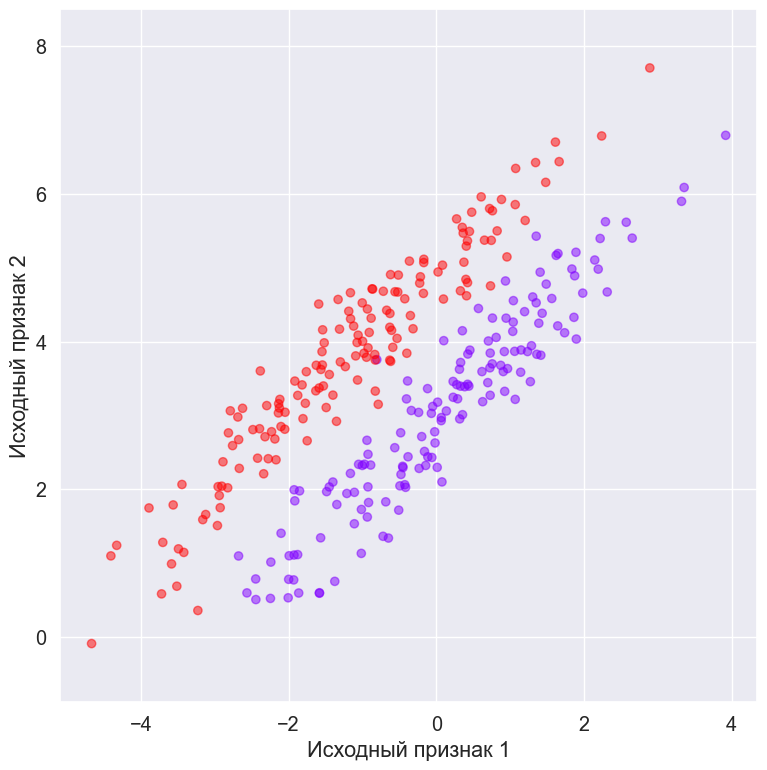

In [14]:
a = sp.stats.multivariate_normal.rvs(size=150, mean=[0, 3], 
                                     cov=[[2, 1.9], [1.9, 2]])
b = sp.stats.multivariate_normal.rvs(size=150, mean=[-1, 4], 
                                     cov=[[2, 1.9], [1.9, 2]])
X = np.vstack([a, b])
c = np.hstack([np.zeros(len(a)), np.ones(len(b))])

plt.figure(figsize=(9, 9))
plt.scatter(X[:, 0], X[:, 1], c=c, alpha=0.5, cmap='rainbow')
plt.xlabel('Исходный признак 1')
plt.ylabel('Исходный признак 2')
plt.xlim((-5, 5)), plt.ylim((-1, 9))
plt.axis('equal')
plt.show()

Главная компонента направлена вдоль этих классов, и при проецировании точки классов смешаются.

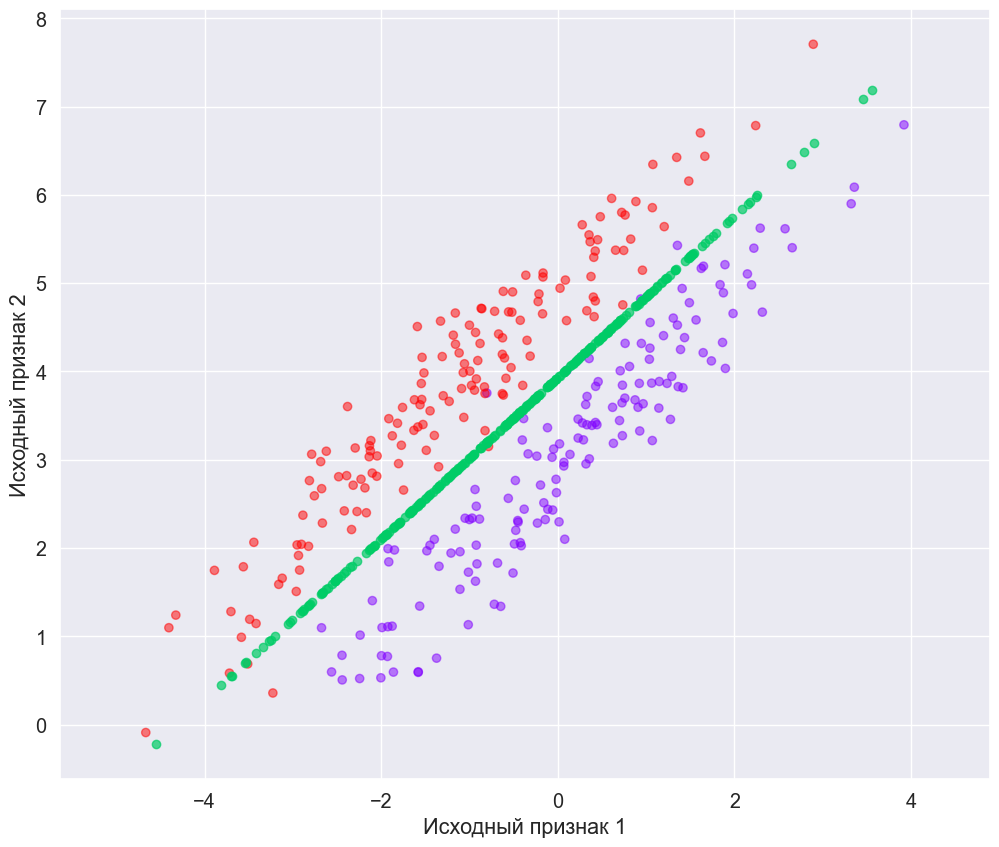

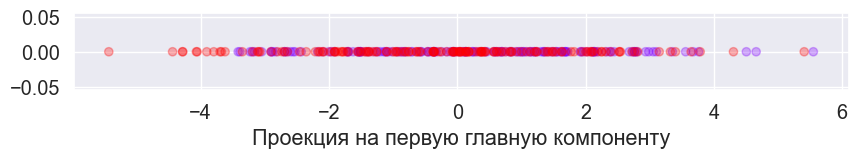

In [15]:
pca = PCA(n_components=1)
Y = pca.fit_transform(X)
X_hat = pca.inverse_transform(Y)

plt.figure(figsize=(12, 10))
plt.scatter(X[:, 0], X[:, 1], c=c, alpha=0.5, cmap='rainbow')
plt.scatter(X_hat[:, 0], X_hat[:, 1], c=green, alpha=0.7)
plt.xlabel('Исходный признак 1')
plt.ylabel('Исходный признак 2')
plt.xlim((-5, 5)), plt.ylim((-1, 9))
plt.axis('equal')
plt.show()

plt.figure(figsize=(10, 1))
plt.scatter(Y, np.zeros(len(Y)), c=c, alpha=0.3, cmap='rainbow')
plt.xlabel('Проекция на первую главную компоненту')
plt.show()

Генерируем трехмерный датасет из нормального распределения.

In [16]:
a = sp.stats.multivariate_normal.rvs(size=150, mean=[-2, 1, 0], 
                                     cov=[[3, -1, 1], 
                                          [-1, 4, 0.5], 
                                          [1, 0.5, 1.5]])
b = sp.stats.multivariate_normal.rvs(size=150, mean=[7, 3, 4], 
                                     cov=[[3, 2, 1], 
                                          [2, 4, 0.5], 
                                          [1, 0.5, 1.5]])
X = np.vstack([a, b])
c = np.hstack([np.zeros(len(a)), np.ones(len(b))])

Визуализируем датасет.

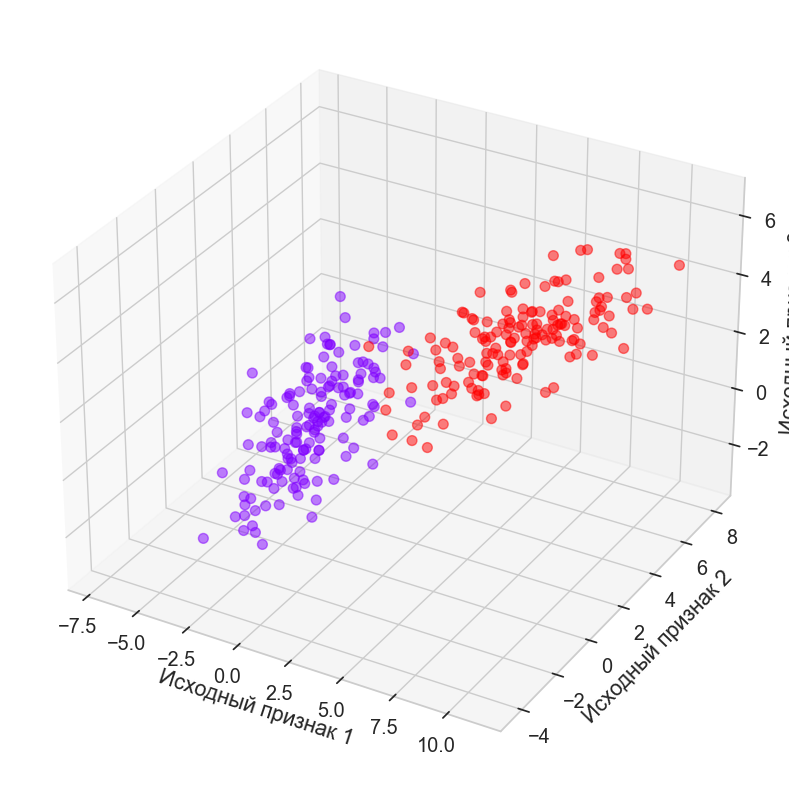

In [17]:
sns.set(font_scale=1.3, style='whitegrid')

fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X[:, 0], X[:, 1], X[:, 2], 
           s=50, c=c, alpha=0.5, cmap='rainbow')
ax.set_xlabel('Исходный признак 1')
ax.set_ylabel('Исходный признак 2')
ax.set_zlabel('Исходный признак 3')
# ax.axis('equal')
plt.show()

Посмотрим на проекции на две первые главные компоненты.

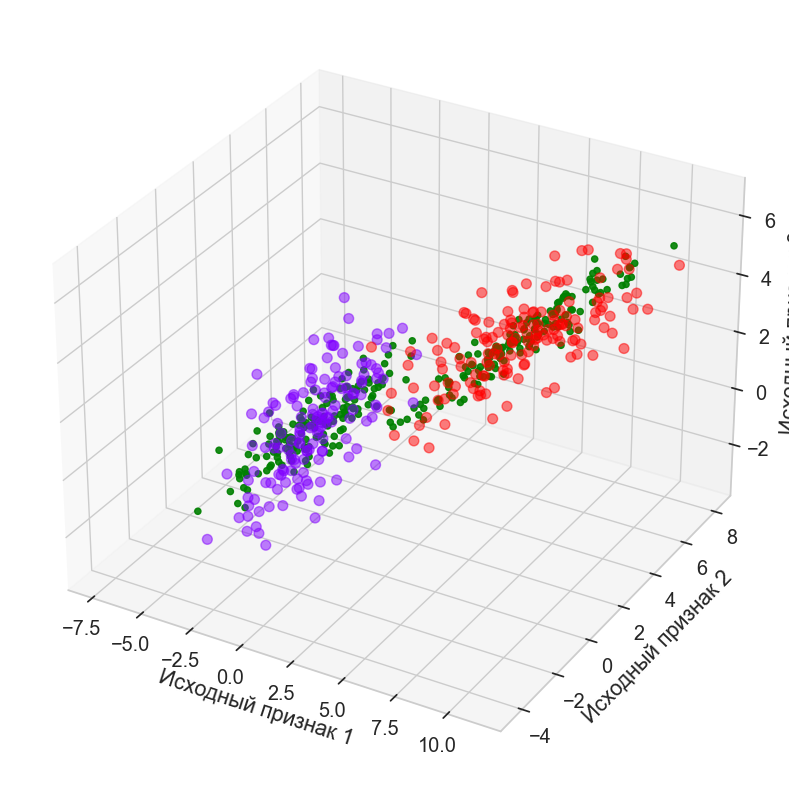

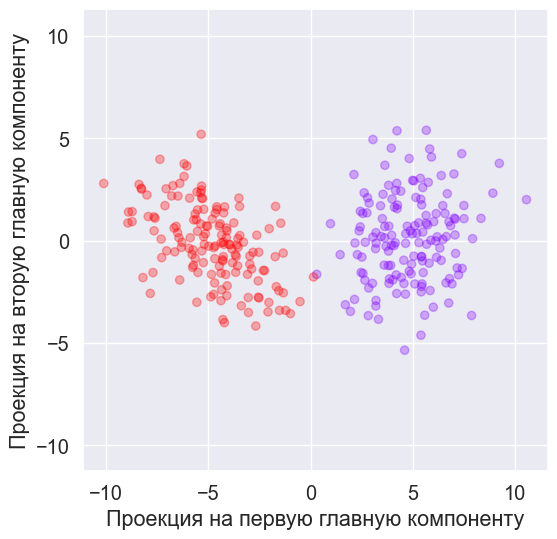

In [18]:
pca = PCA(n_components=2)
Y = pca.fit_transform(X)
X_hat = pca.inverse_transform(Y)

fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X[:, 0], X[:, 1], X[:, 2], 
           s=50, c=c, alpha=0.5, cmap='rainbow')
ax.scatter(X_hat[:, 0], X_hat[:, 1], X_hat[:, 2], 
           s=20, c='green', alpha=0.9)
ax.set_xlabel('Исходный признак 1')
ax.set_ylabel('Исходный признак 2')
ax.set_zlabel('Исходный признак 3')
# ax.axis('equal')
plt.show()

sns.set(font_scale=1.3)
plt.figure(figsize=(6, 6))
plt.scatter(Y[:, 0], Y[:, 1], c=c, alpha=0.3, cmap='rainbow')
plt.xlabel('Проекция на первую главную компоненту')
plt.ylabel('Проекция на вторую главную компоненту')
plt.axis('equal')
plt.show()

Нарисуем интерактивный график для удобной визуализации.

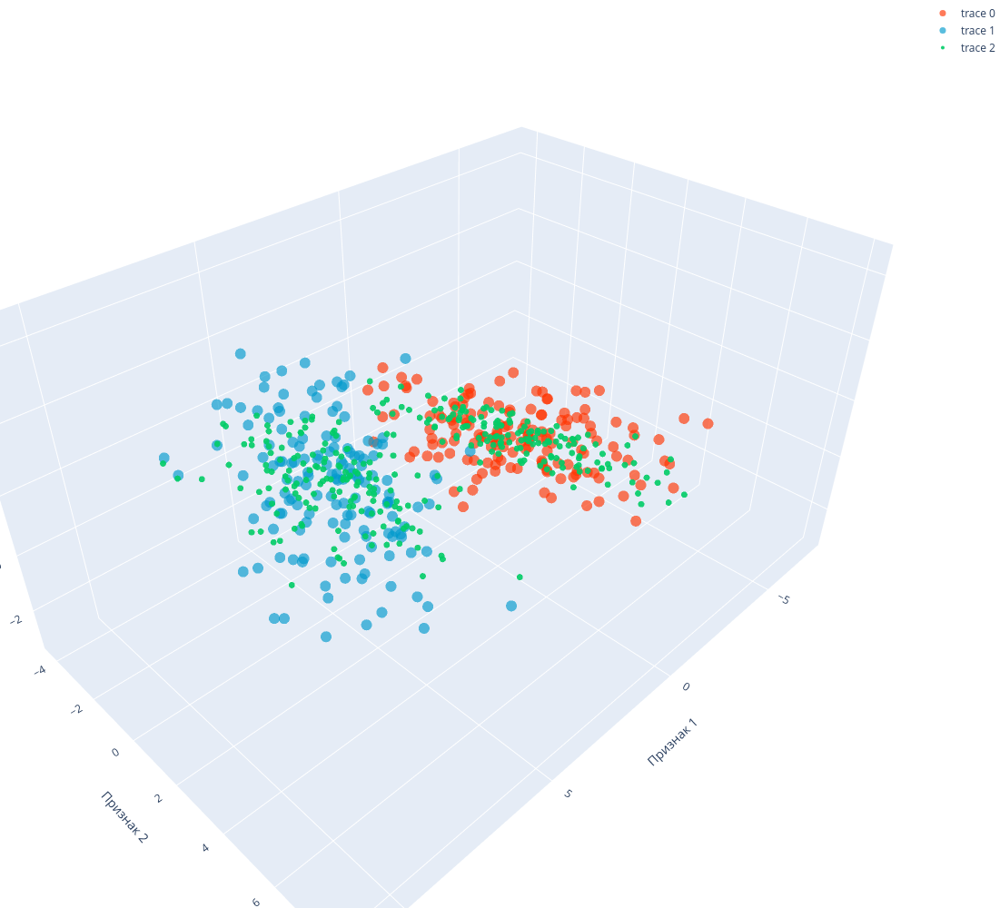

In [19]:
fig = go.Figure()
fig.update_layout(
        autosize=False,
        width=1000,
        height=1000,
)

fig.add_trace(go.Scatter3d(
    x=X[c==0, 0], y=X[c==0, 1], z=X[c==0, 2], mode='markers',
    marker={'size': 7, 'opacity': 0.65, 'color': red}
))

fig.add_trace(go.Scatter3d(
    x=X[c==1, 0], y=X[c==1, 1], z=X[c==1, 2], mode='markers',
    marker={'size': 7, 'opacity': 0.65, 'color': blue}
))

fig.add_trace(go.Scatter3d(
    x=X_hat[:, 0], y=X_hat[:, 1], z=X_hat[:, 2], mode='markers',
    marker={'size': 4, 'opacity': 0.9, 'color': green}
))

fig.update_layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0},
        scene = dict(
            xaxis_title='Признак 1',
            yaxis_title='Признак 2',
            zaxis_title='Признак 3',
        )
    )

# Отображение.
plotly.offline.iplot(fig)

## 3. Снижение размерности фотографий лиц

Загрузим датасет человеческих лиц.
Выборка состоит из 280 изображений лиц, каждое имеет размер $32$x$32$.
Каждый пиксель принимает значения от $0$ до $255$.
Для того, чтобы работать с изображением как с вектором, матрица пикселей растянута в вектор размерности $32*32 = 1024$.

In [18]:
X = np.loadtxt('train_faces.npy')
print(X)
print(X.shape)

[[ 86. 115. 145. ... 114.  19.  28.]
 [112. 136. 154. ...  47.  48.  49.]
 [ 54.  51.  55. ...  88. 101. 115.]
 ...
 [136. 147. 146. ...  71.  72.  73.]
 [101. 133. 145. ...  73.  72.  70.]
 [164. 168. 171. ...  73.  73.  75.]]
(280, 1024)


Посмотрим, как вообще выглядят эти лица.

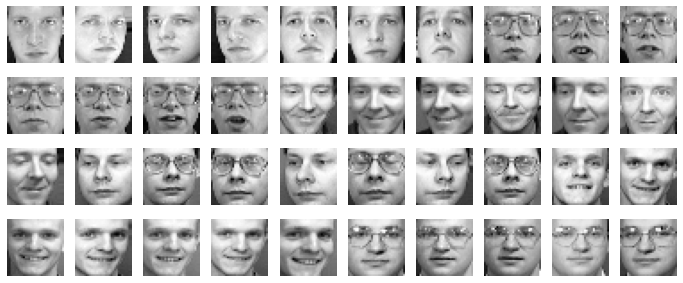

In [19]:
plt.figure(figsize=(12, 5))    
for i in range(40):
    plt.subplot(4, 10, i + 1)
    plt.imshow(X[i].reshape((32, 32)), cmap='gray')
    plt.axis('off')

Выборку лиц можно визуализировать с помощью PCA. Рассмотрим проекции на первые две главные компоненты.

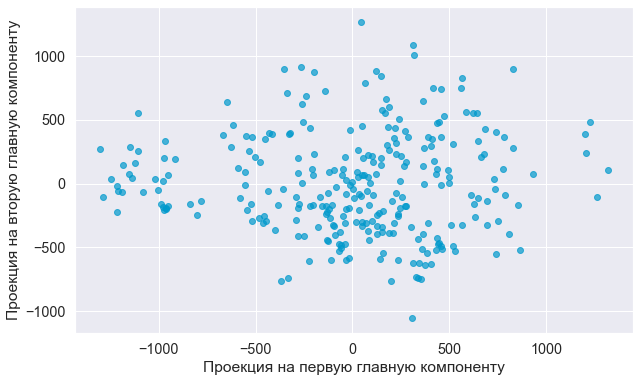

In [20]:
pca = PCA(n_components=2)
transform_X = pca.fit_transform(X)

plt.figure(figsize=(10, 6))
plt.scatter(transform_X[:, 0], transform_X[:, 1], 
            alpha=0.7, color='#0099CC')
plt.xlabel('Проекция на первую главную компоненту')
plt.ylabel('Проекция на вторую главную компоненту')
plt.show()

Посчитаем сингулярные числа по лицам.

In [21]:
singular_values = sp.linalg.svdvals(X)
print(singular_values)

[72911.38123949  6685.358435    5172.74579791  4077.64679037
  3657.21965417  3246.35711102  2957.85045808  2770.96106073
  2631.12047638  2394.20945854  2309.21626861  2140.94235126
  1986.75865445  1956.96705992  1859.54927047  1801.04592215
  1775.63605748  1746.740345    1592.13972449  1567.6069856
  1551.44828179  1489.31018253  1427.72294286  1402.18848594
  1393.86766918  1357.16710503  1333.39112928  1287.16489912
  1262.50086769  1201.15479691  1169.13616197  1140.98060174
  1102.72429995  1092.56353611  1067.42624781  1050.91927287
  1019.94926967  1003.59615473   990.1154481    962.17857553
   942.10016428   940.58624338   927.85855002   912.09448538
   908.31935828   887.86855295   877.33677684   856.79688123
   851.17658821   840.95465052   827.29583358   819.59956317
   805.55623324   798.45813415   785.37439005   780.70367402
   769.28057342   761.75978119   757.54855328   746.9257434
   736.53414257   726.45868039   714.07377027   708.6807895
   700.5372487    691.23445

По сингулярным числам можно построить график доли необясненной дисперсии.

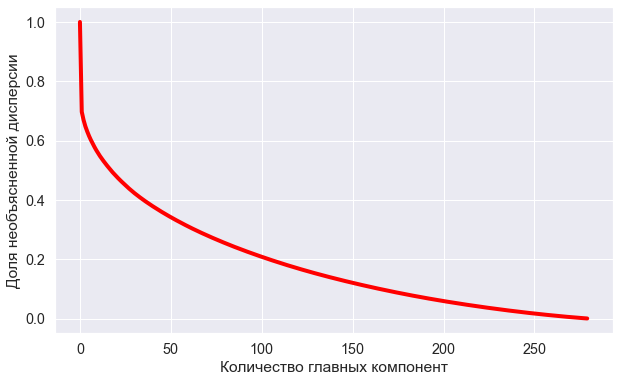

In [22]:
error = singular_values[::-1].cumsum() / singular_values.sum()
error = error[::-1]

plt.figure(figsize=(10, 6))
plt.plot(range(len(error)), error, c='red', linewidth=4)
plt.xlabel('Количество главных компонент')
plt.ylabel('Доля необъясненной дисперсии')
plt.show()

Теперь посмотрим на то, что такое главные компоненты.


In [23]:
pca = PCA(n_components=50)
transform_X = pca.fit_transform(X)

Ниже на первой строке изображено среднее лицо, которое получается путем усреднения всех лиц по выборке.
Далее в строчках изображены главные компоненты в порядке убывания их степени важности.

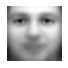

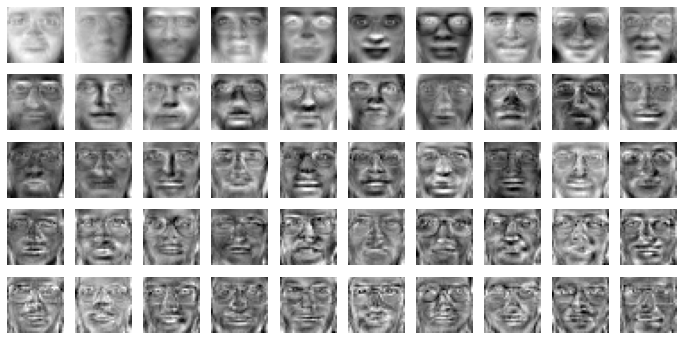

In [24]:
plt.figure(figsize=(1, 1))
plt.imshow(pca.mean_.reshape((32, 32)), cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(12, 6))    
for i in range(50):
    plt.subplot(5, 10, i + 1)
    plt.imshow(pca.components_[i].reshape((32, 32)), cmap='gray')
    plt.axis('off')

Посмотрим на то, как восстанавливаются лица по главным компонентам.
Для наглядности возьмем первые 10 компонент.

In [25]:
pca = PCA(n_components=10)
transform_X = pca.fit_transform(X)

Ниже в первой колонке изображено исходное лицо, во второй его приближение (проекция на первые 10 главных компонент).
В третьей колонке среднее лицо, и в следующих 10 колонках первые 10 главных компонент.
Над компонентами указаны коэффициенты, с которыми они входят в приближаемое лицо.

Стоит отметить, что все компоненты нормированны, однако при отрисовке они растягиваются до диаппазона [0, 255].
Поэтому коэффициенты относятся не к изображениям компонент, а к самим нормированным компонентам.

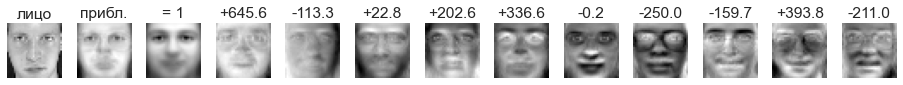

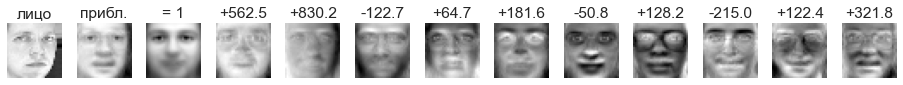

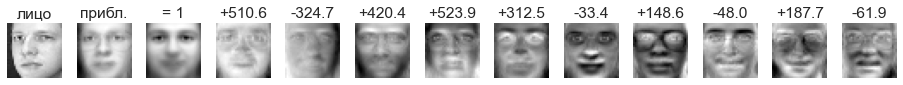

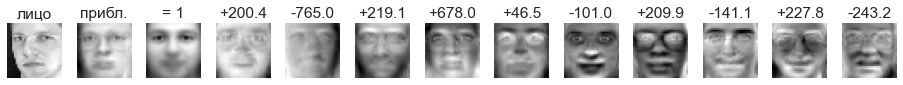

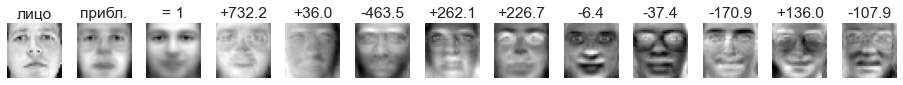

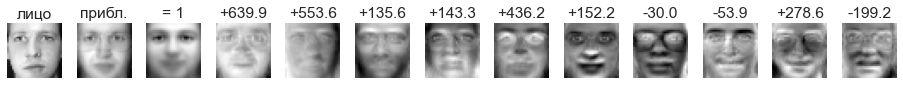

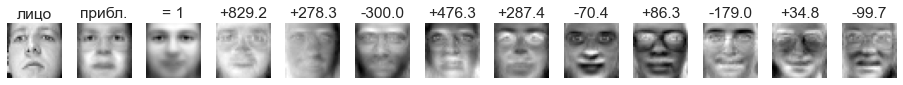

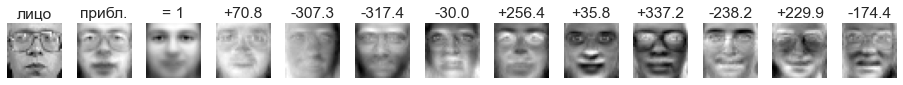

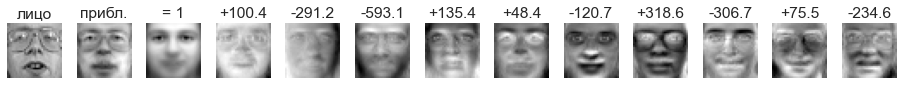

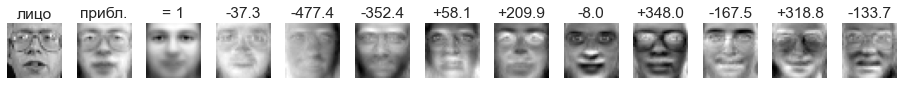

In [26]:
for i in range(10):
    X_hat = pca.inverse_transform(transform_X[i])
    plt.figure(figsize=(16, 1))
    
    plt.subplot(1, 13, 1)
    plt.imshow(X[i].reshape((32, 32)), cmap='gray')
    plt.axis('off')
    plt.title('лицо')
    
    plt.subplot(1, 13, 2)
    plt.imshow(X_hat.reshape((32, 32)), cmap='gray')
    plt.axis('off')
    plt.title('прибл.')
    
    plt.subplot(1, 13, 3)
    plt.imshow(pca.mean_.reshape((32, 32)), cmap='gray')
    plt.axis('off')
    plt.title('= 1')
    
    for j in range(10):
        plt.subplot(1, 13, 4 + j)
        plt.imshow(pca.components_[j].reshape((32, 32)), cmap='gray')
        plt.axis('off')
        plt.title('{}{:.1f}'.format('+' if transform_X[i, j] >= 0 else '', 
                                    transform_X[i, j]))
        
    plt.show()

**Вывод:** мы получили способ уменьшения размерности для целого датасета изображений. Понятно, что теперь для приближения каждого лица из датасета нужно хранить намного меньше параметров: достаточно оставить главные компоненты и значение коэффициентов при этих главных компонентах. Такой способ хранения можно использовать, когда мы готовы пожертвовать качеством хранимого изображения в угоду потребляемой памяти.

## 4. Cжатие изображений с помощью PCA

Попробуем теперь выполнить сжатие для одного изображения очень большого размера.

### 4.1. Проекция на главные компоненты

Загрузим картинку.

In [5]:
image = plt.imread('3840x2400.jpeg')
image.shape

(2400, 3840, 3)

In [ ]:
plt.figure(figsize=(12, 10))

plt.imshow(image)
plt.grid()

Применим к картинке преобразование для выделения 24 блоков размера 600x640.

In [7]:
X = image.transpose((1, 2, 0)).reshape((3840, 3, 4, 600)) \
         .transpose((1, 2, 3, 0)).reshape((3, 4, 600, 6, 640)) \
         .transpose((1, 3, 2, 4, 0)).reshape((4 * 6, 600 * 640 * 3))
print(X.shape)

(24, 1152000)


Визуализируем блоки.
Как видим, все правильно.

In [ ]:
plt.figure(figsize=(11, 7))
for i in range(24):
    plt.subplot(4, 6, i + 1)
    plt.imshow(X[i].reshape((600, 640, 3)))
    plt.axis('off');

Напишем несколько функций.
Первая рисует главные компоненты, вторая рисует график доли необъясненной дисперсии.
Третья функция для картинки выполняет все остальные действия.

In [9]:
def draw_components(pca, n, m):
    """Функция визуализации главных  компонент
    
    :param pca: объект PCA-декомпозиции,
    :param n: высота изображения,
    :param m: ширина изображения,
    """
    print('Среднее изображение')
    plt.figure(figsize=(1, 1))
    plt.imshow(pca.mean_.reshape((n, m, 3)), cmap='gray')
    plt.axis('off')
    plt.show()

    print('Главные компоненты')
    plt.figure(figsize=(11, len(pca.components_) // 10 + 1))
    for i, comp in enumerate(pca.components_):
        plt.subplot(len(pca.components_) // 10 + 1, 10, i + 1)
        img = pca.components_[i].reshape((n, m, 3))
        plt.imshow((img - img.min()) / (img.max() - img.min()), cmap='gray')
        plt.axis('off')
    plt.show()
        
        
def draw_residual_variance(X):
    """Функция визуализации главных  компонент
    
    :param X: матрица,
    """
    singular_values = sp.linalg.svdvals(X)
    error = singular_values[::-1].cumsum() / singular_values.sum()
    error = error[::-1]

    plt.figure(figsize=(10, 6))
    plt.plot(range(len(error)), error, c='red', linewidth=4)
    plt.xlabel('Количество главных компонент')
    plt.ylabel('Доля необъясненной дисперсии')
    plt.show()

        
def image_pca(image, n, m, n_components=20, draw_picture=True, 
              draw_comp=True, draw_rv=True, visualization=True):
    """Функция визуализации главных  компонент
    
    :param image: исходное изображение,
    :param n: высота изображения,
    :param m: ширина изображения,
    :param n_components: число главных компонент,
    :param draw_picture: визуализировать ли изображение,
    :param draw_comp: визуализировать ли главные компоненты,
    :param draw_rv: строить ли график необъясненной дисперсии,
    :param visualization: визуализировать ли проекцию на 3 первые компоненты,
    """
    
    # Показываем исходную картинку
    if draw_picture:
        plt.figure(figsize=(15, 7))
        plt.imshow(image)
        plt.axis('off')
        plt.show()
    
    # Разбиение на блоки
    N, M, K = image.shape
    X = image.transpose((1, 2, 0)).reshape((M, K, N // n, n)) \
             .transpose((1, 2, 3, 0)).reshape((K, N // n, n, M // m, m)) \
             .transpose((1, 3, 2, 4, 0)).reshape((N * M // (n * m), n * m * K))
    X = X.reshape((N * M // (n * m), n * m * K))
    
    # Определение размера сжатия
    size_with_comp = (N * M * K) // ((N * M // (n * m) + n * m * K) * n_components)
    size_without_comp = (N * M * K) // (N * M // (n * m) * n_components)
    
    # Применение PCA
    pca = PCA(n_components=n_components)
    Y = pca.fit_transform(X)
    X_hat = pca.inverse_transform(Y)
    
    # Разбираемся с интенсивностью цвета
    max_value = X.max()
    X_hat = X_hat * (X_hat <= max_value) + max_value * (X_hat > max_value)
    X_hat = X_hat * (X_hat >= 0) / max_value
    
    # Собираем картинку из блоков
    X_hat = X_hat.reshape((N // n, M // m, n, m, K)).transpose((1, 3, 4, 0, 2))\
                 .reshape((M // m, m, K, N)).transpose((3, 2, 0, 1))\
                 .reshape((N, K, M)).transpose((0, 2, 1))
    
    # Рисуем восстановленную картинку
    plt.figure(figsize=(15, 7))
    plt.imshow(X_hat)
    plt.axis('off')
    plt.title('Восстановленное изображение при {} главных компонентах.\n'.format(n_components) +
              'Сжатие в {} раз с учетом главных компонент'.format(round(size_with_comp, 2)) +
              ' и в {} раз без из учета.'.format(round(size_without_comp, 2)))
    plt.show()
    
    # Если нужно, рисуем главные компоненты и график доли необъясненной дисперсии
    if draw_comp:
        draw_components(pca, n, m)
    if draw_rv:
        draw_residual_variance(X)
    
    # Визуализируем проекцию на первые три компоненты (третья - цвет)
    if visualization:
        pca = PCA(n_components=3)
        Y = pca.fit_transform(X)
        plt.figure(figsize=(15, 10))
        plt.scatter(Y[:, 0], Y[:, 1], c=Y[:, 2], alpha=0.1)
        plt.xlabel('Проекция на первую главную компоненту')
        plt.ylabel('Проекция на вторую главную компоненту')
        plt.title('Проекция на первые три компоненты (третья - цвет)')
        plt.show()

Продемонстрируем результаты для нескольких различных изображений:

(2400, 3840, 3)


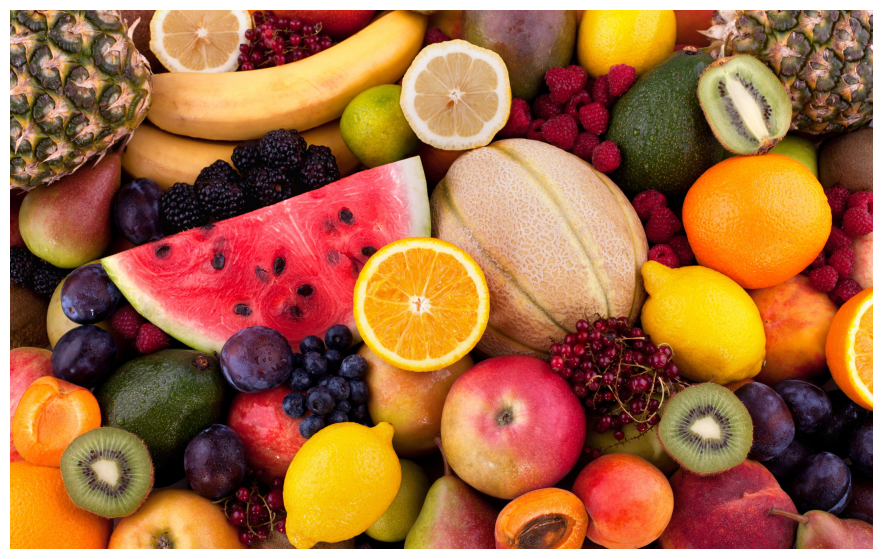

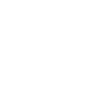

Главные компоненты


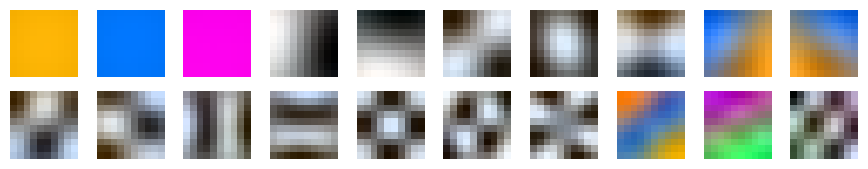

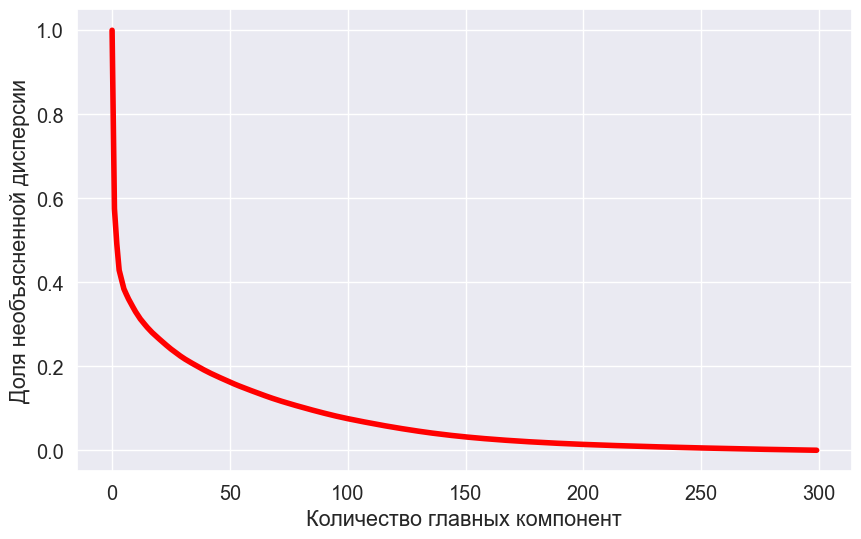

In [ ]:
image = plt.imread('3840x2400.jpeg')
print(image.shape)
image_pca(image, 10, 10)

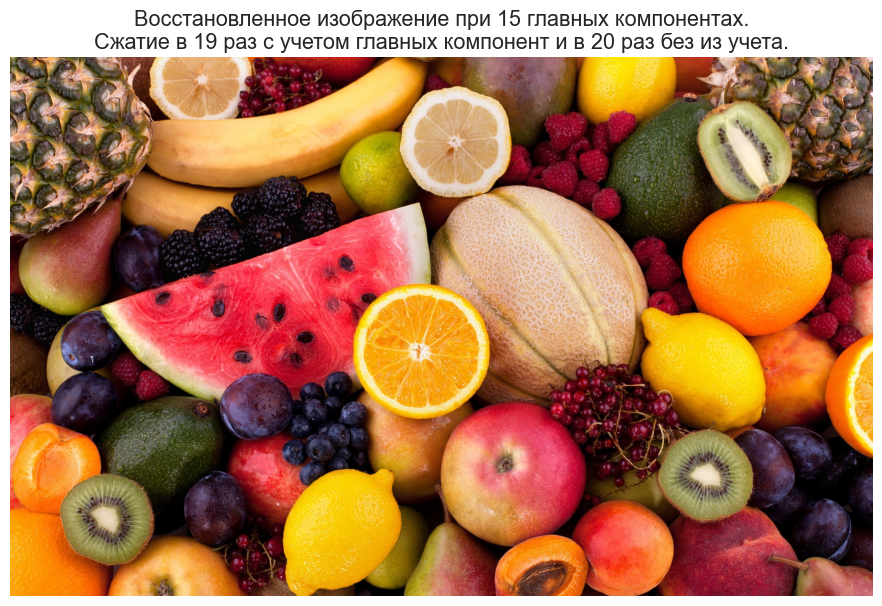

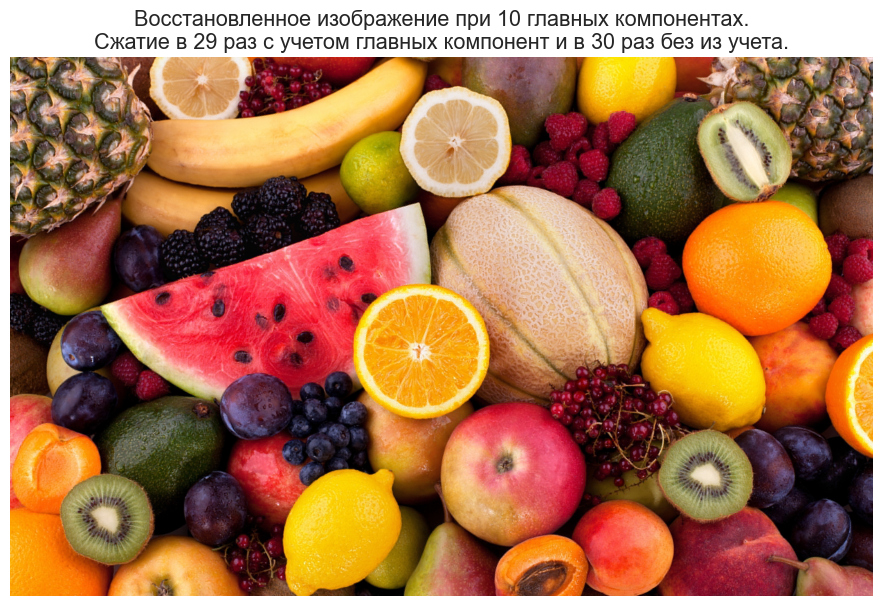

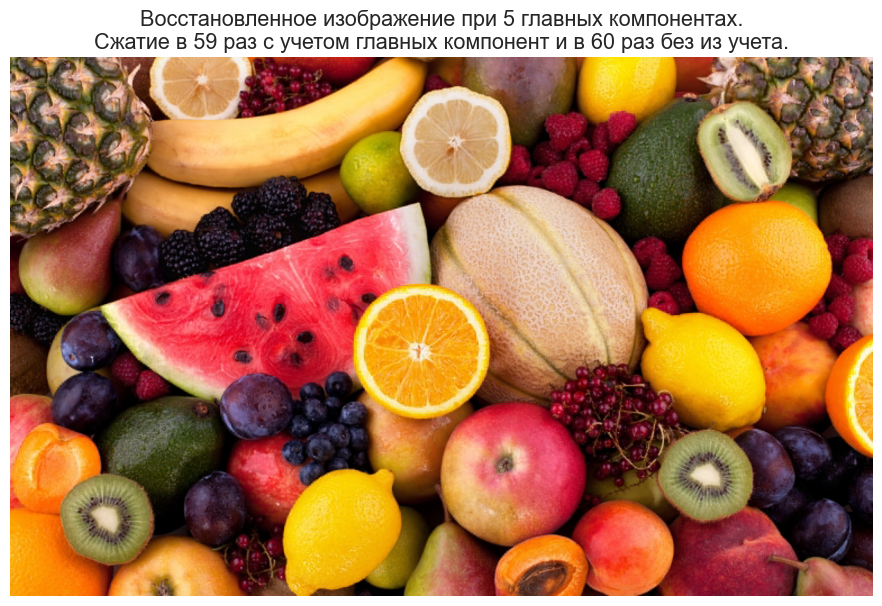

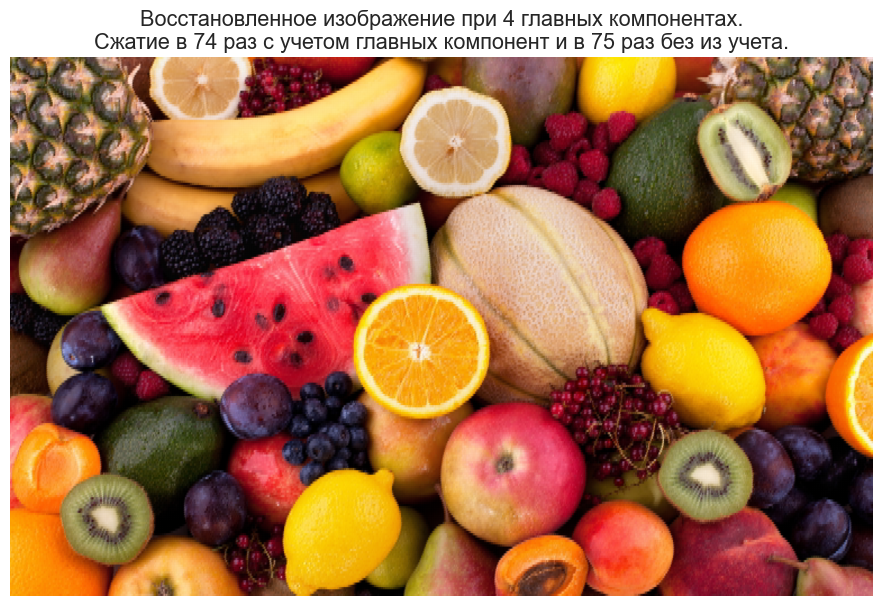

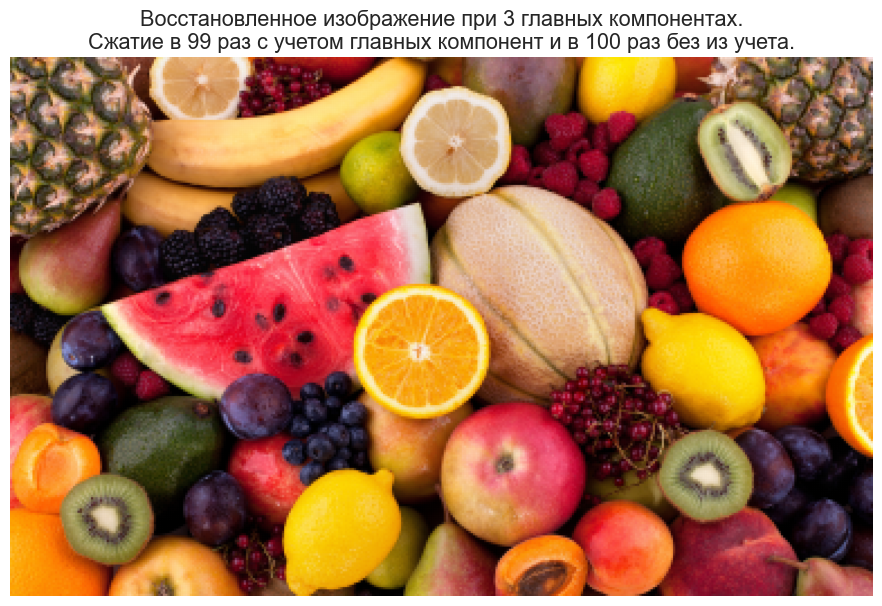

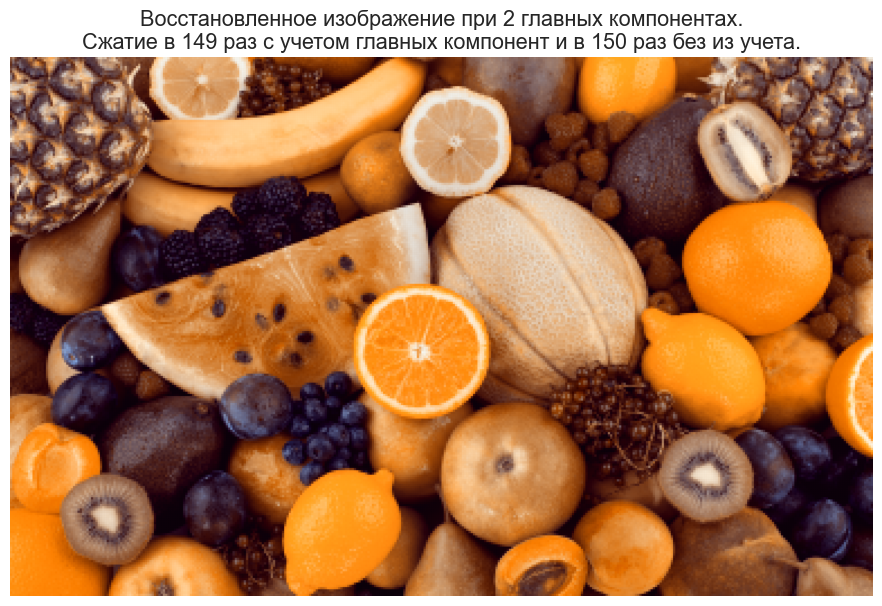

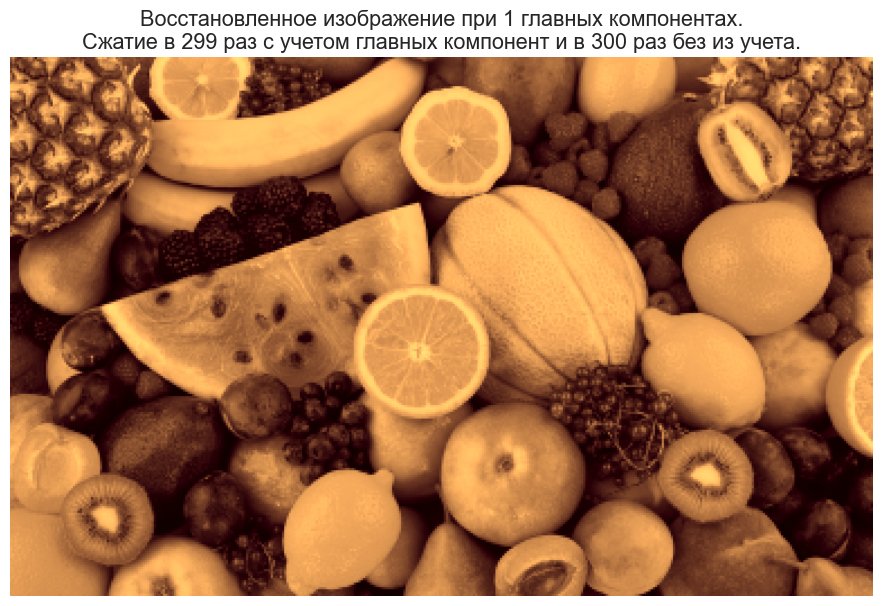

In [11]:
for n_components in [15, 10, 5, 4, 3, 2, 1]:
    image_pca(image, 10, 10, 
              n_components=n_components, draw_picture=False,
              draw_comp=False, draw_rv=False, visualization=False)

### 4.3. Другие примеры изображений
Применим данный способ для сжатия другой картинки.

(819, 1246, 3)


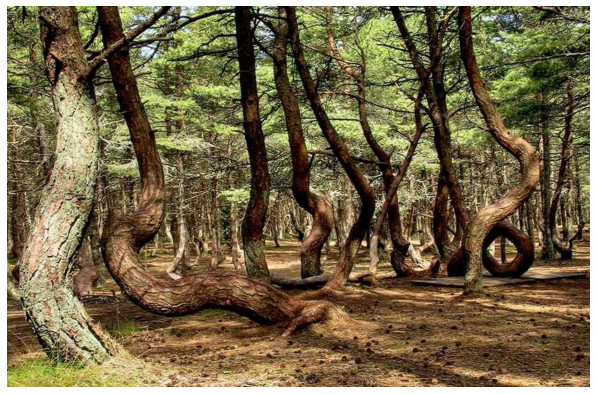

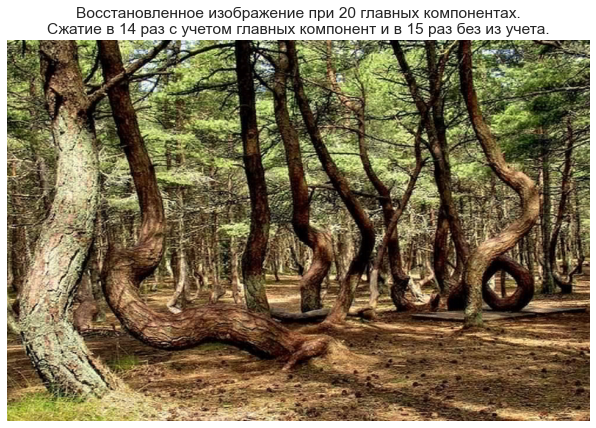

Среднее изображение


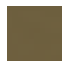

Главные компоненты


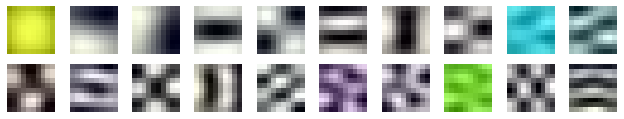

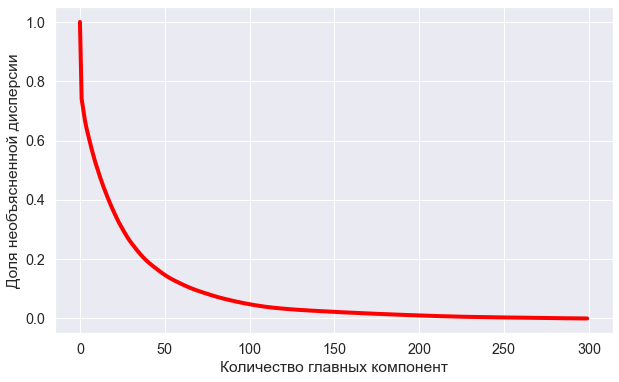

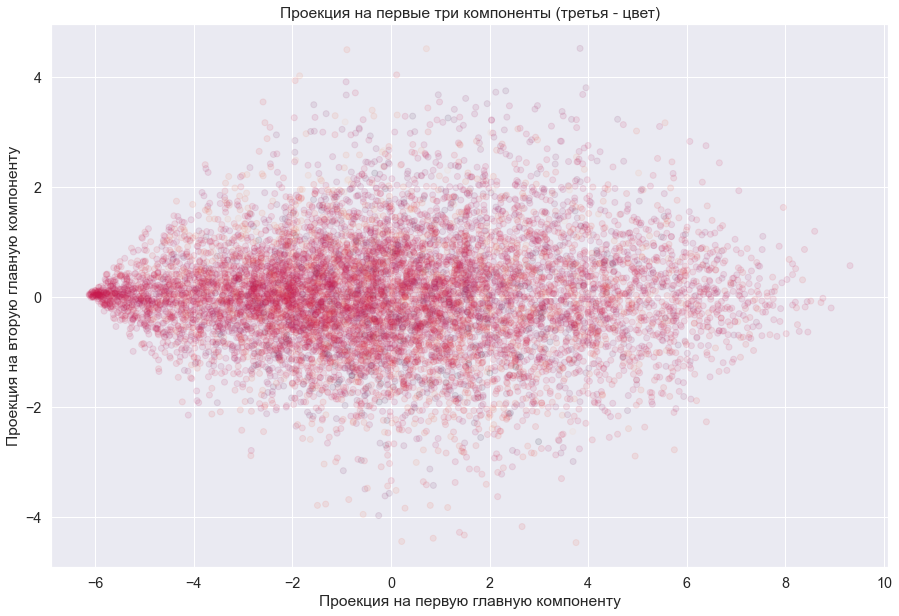

In [37]:
image = plt.imread('forest.png')
print(image.shape)
image_pca(image[:810, :1240, :], 10, 10)

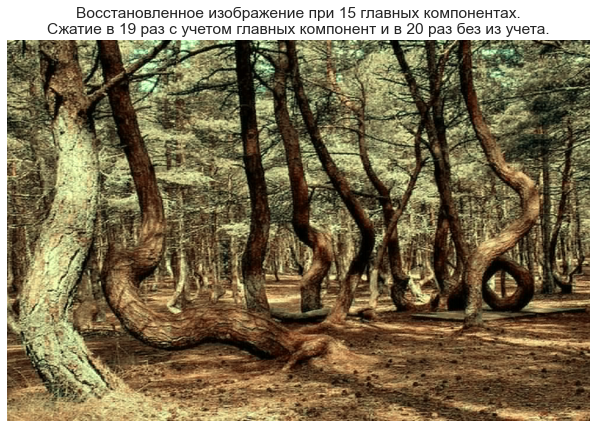

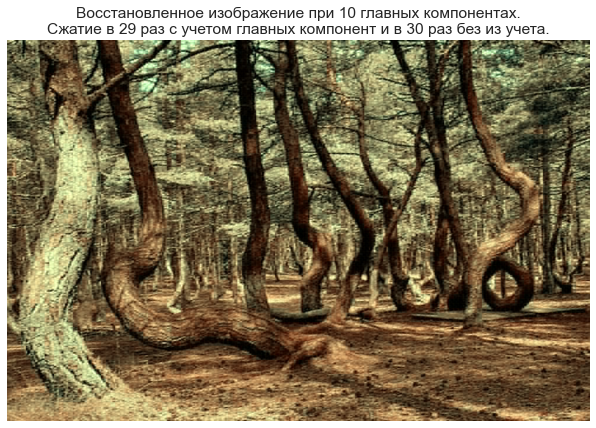

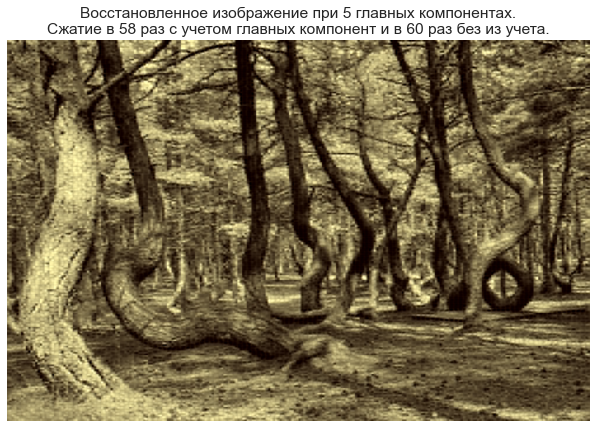

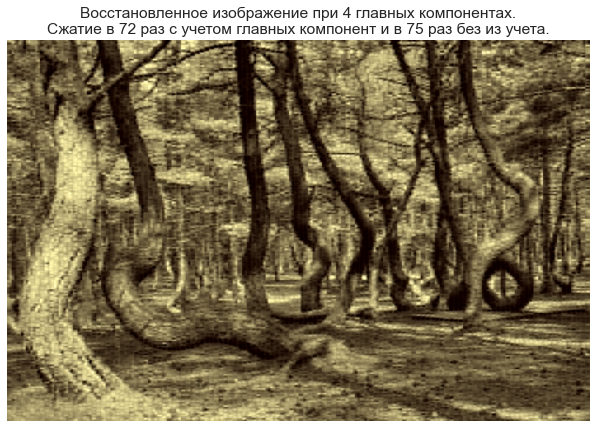

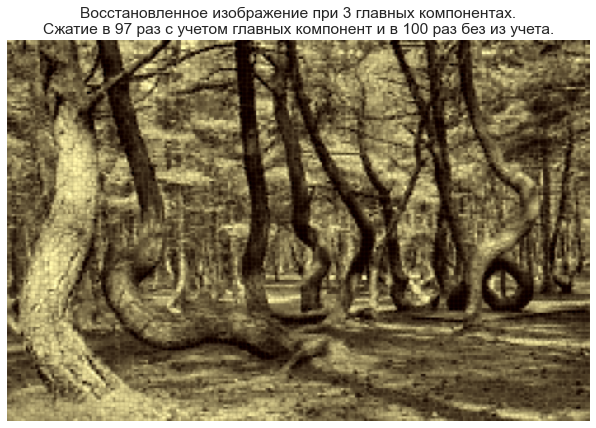

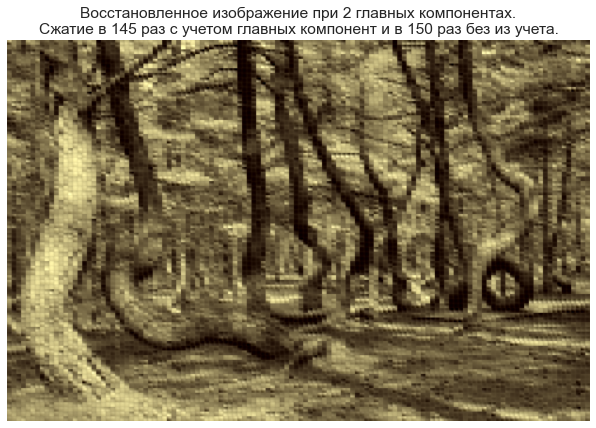

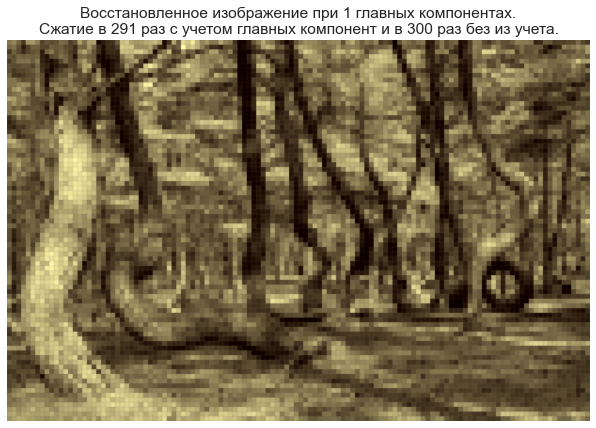

In [38]:
for n_components in [15, 10, 5, 4, 3, 2, 1]:
    image_pca(image[:810, :1240, :], 10, 10, 
              n_components=n_components, draw_picture=False,
              draw_comp=False, draw_rv=False, visualization=False)

## 5. Другие методы снижения размерности

http://scikit-learn.org/stable/modules/manifold.html#manifold

Примеры:

http://scikit-learn.org/stable/auto_examples/manifold/plot_compare_methods.html#sphx-glr-auto-examples-manifold-plot-compare-methods-py

http://scikit-learn.org/stable/auto_examples/manifold/plot_manifold_sphere.html#sphx-glr-auto-examples-manifold-plot-manifold-sphere-py